<a href="https://colab.research.google.com/github/nikolaf91/PythonML-MNIST/blob/main/MNIST_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
def check():
    import pkg_resources
    import subprocess
    import sys

    REQUIRED_PACKAGES = [
        'idx2numpy',
        'sklearn',
        'plotly',
        'umap-learn',
        'scipy',
        'numpy',
        'matplotlib',
    ]

    for package in REQUIRED_PACKAGES:
        try:
            dist = pkg_resources.get_distribution(package)
            print('{} ({}) is installed'.format(dist.key, dist.version))
        except pkg_resources.DistributionNotFound:
            print('{} is NOT installed'.format(package))
            print('Installing...')
            try:
                subprocess.check_call([sys.executable, '-m', 'pip', 'install', package])
            except Exception as e:
                print('pip install failed: {}'.format(e))
                print('Trying with conda...')
                try:
                    subprocess.check_call(['conda', 'install', '-y', package])
                except Exception as e:
                    print('conda install also failed: {}'.format(e))
#check() # only run if you want packages to be checked and installed if missing (prob. needs admin rights)

idx2numpy (1.2.3) is installed
sklearn (0.0) is installed
plotly (5.9.0) is installed
umap (0.1.1) is installed
scipy (1.10.1) is installed
numpy (1.24.3) is installed
matplotlib (3.7.2) is installed


<center><h3> Classification of MNIST dataset (handwritten digits)</h3></center><br>
<center><b>with  the Gaussian Mixture Model (GMM), t-Distributed Stochastic Neighbor Embedding (t-SNE)</b></center>
<center><b>Principal Component Analysis (PCA) and Uniform Manifold Approximation and Projection (UMAP)</b></center> <br>
<center>Author: <author>Nikola Filipovic, B.Sc. (student ID: 01027843)</author><br>
Institution: University of Vienna </center>

<p>
In the following code I am trying to train an unsupervised GMM model with the help of the MNIST dataset (training set: 60000 samples, test set: 10000, each 28x28 images) as well as classify, determine the accuracy of the resulting fit and synthesize new images. Usually, these kind of models are fairly innefficient when it comes to high dimensional and dense datasets. Therefore the so called PCA, t-SNE and UMAP algorithms are used to speed up the process by reducing the dimensionality but maintaining important features of the 28x28 images appropriate for the Gaussian Mixture model.
<br><br><i>Supervised</i> and <i>unsupervised</i> learning. The main difference between both lies in the nature of the data as well as the approaches used to deal with it. Clustering is an unsupervised learning problem where one intends to find clusters of points in the given dataset that share some common characteristics.</p>


In [ ]:
import idx2numpy
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture as gm
import warnings
warnings.simplefilter("ignore")
from scipy import linalg
from scipy.linalg import eigh
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
import plotly.graph_objects as go
import plotly.express as px
from sklearn.manifold import TSNE
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from scipy.optimize import linear_sum_assignment
import umap.umap_ as ump
from scipy.spatial.distance import cdist

test_imx = 't10k-images.idx3-ubyte'
train_imx = 'train-images.idx3-ubyte'
test_labelx = 't10k-labels.idx1-ubyte'
train_labelx = 'train-labels.idx1-ubyte'

test_im = idx2numpy.convert_from_file(test_imx)
train_im = idx2numpy.convert_from_file(train_imx)
test_label = idx2numpy.convert_from_file(test_labelx)
train_label = idx2numpy.convert_from_file(train_labelx)

<h4>Some plots:</h4>

First 100 samples from the training data:


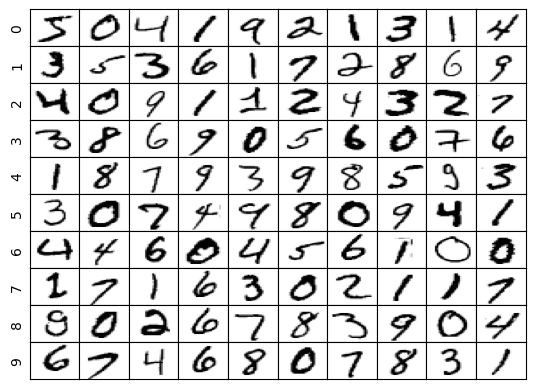

In [ ]:
def plot1(title1, title2, itrain, itest):
    fig, ax = plt.subplots(1, 2, sharey=True)
    plt.figure(figsize = (0.5,0.25))
    ax[0].set_title(title1)
    ax[1].set_title(title2)
    ax[0].imshow(itrain)
    ax[1].imshow(itest)
    ax[0].axes.get_xaxis().set_visible(False)
    ax[0].axes.get_yaxis().set_visible(False)
    ax[1].axes.get_yaxis().set_visible(False)
    ax[1].axes.get_xaxis().set_visible(False)
    plt.show()

def plot3(trainx,labels, title):
    plt.figure(figsize=(8,6))
    sc = plt.scatter(trainx[:,0], trainx[:,1], c=labels, s=40, cmap='viridis')
    plt.xlabel('PC1')
    plt.ylabel('PC2')
    plt.title(title)
    hs, ls = sc.legend_elements()
    plt.legend(hs, ls)
    plt.show()

def plot3d(trainx, labels, title):

    fig = px.scatter_3d(trainx, x=0, y=1, z=2, color=labels, color_continuous_scale="viridis")

    fig = go.Figure(data=[go.Scatter3d(x=trainx[:, 0], y=trainx[:, 1], z=trainx[:, 2], mode="markers",
        marker=dict(size=5,color=labels, colorscale="Viridis", opacity=0.8),hovertext=labels)])

    fig.update_layout(title=title, scene=dict(xaxis_title="PC1", yaxis_title="PC2", zaxis_title="PC3"))

    fig.show()

def plot4(imx, k):
    fig, axes = plt.subplots(10, 10)
    fig.subplots_adjust(hspace=0, wspace=0)
    for i, ax in enumerate(axes.flat):
        ax.imshow(imx[i], aspect='auto', cmap="Greys")
        if(i%10==0):
            ax.set_ylabel(k[i//10])
        ax.set_xticks([])
        ax.set_yticks([])

    plt.show()

print("First 100 samples from the training data:")
plot4(train_im[:100], np.arange(0,10))


def sampler(gmm, label_mapping, mapper=None):
    all_images = []
    all_labels = []
    # Loop over the cluster labels from 0 to 9
    for cluster_label in range(10):
        # Find the true label that maps to the cluster label from "label_mapping"
        true_label = label_mapping[cluster_label]
        # Use the mean point of the cluster as the sample point
        sample = gmm.means_[cluster_label]
        if(mapper != None):
            # Transform the sample point from the mapped space to the orig. image space
            sample = mapper.inverse_transform(sample.reshape(1, -1))
        sample = np.reshape(sample, (28, 28))
        all_images.append(sample)
        all_labels.append(true_label)

    all_images = np.array(all_images)
    all_labels = np.array(all_labels)
    # Sort the images and labels arrays using the sorted indices
    sorted_indices = np.argsort(all_labels)
    all_images = all_images[sorted_indices]
    all_labels = all_labels[sorted_indices]

    # Concatenate the sorted images horizontally
    all_images = np.concatenate(all_images, axis=1)

    plt.imshow(all_images, cmap="Greys")
    plt.title('Synthesized images of numbers from 0 to 9')
    plt.xticks([])
    plt.yticks([])
    plt.show()


<h3>Reshape and Standardization: </h3>
<br>Reshaping the data into 2 dimensions for further analysis and applying preprocessing since PCA yields a feature subspace that maximizes the variance along the axes, it makes sense to standardize the data, especially, if it was measured on different scales. Transformation onto unit scale (mean=0 and variance=1) is usually the right choice since it is a requirement for the optimal performance of many machine learning algorithms.

For further (exploratory) analysis and reducing execution/iteration time the sample size has been limited to 8000. A trade-off to to try maximizing the variation in the data without losing too much of the representativeness and minimizing "noise".

In [ ]:
print("(orig.) training dataset shape: ", np.shape(train_im))
print("(orig.) test dataset shape: ", np.shape(test_im))
trains = train_im.reshape(60000, 784)
tests = test_im.reshape(10000, 784)
scaler = StandardScaler()
st_train = scaler.fit_transform(trains)
st_test = scaler.transform(tests)

# reduce sample size to reduce execution time for (exploratory) analysis
samples_size = 8000
train_8k, train_label_8k = st_train[:samples_size], train_label[:samples_size]

print("\nactive (truncated) training dataset shape: ", np.shape(train_8k))
print("active test dataset shape: ", np.shape(st_test))

(orig.) training dataset shape:  (60000, 28, 28)
(orig.) test dataset shape:  (10000, 28, 28)

active (truncated) training dataset shape:  (8000, 784)
active test dataset shape:  (10000, 784)


<h3><b>Gaussian Mixture Model (GMM):</b></h3>

A Gaussian Mixture Model is a probabilistic model that assumes all the data points are generated from a mixture of a finite number of Gaussian distributions (components) with unknown parameters. One can think of mixture models as generalizing K-means clustering to incorporate information about the covariance structure of the data as well as the centers of the Gaussians. Therefore the Gaussian mixture model is kind of a "soft" variant of K-means. <br><br>
  
<ol>
    <li><b>Create a Gaussian Mixture comprised of several Gaussians, each identified by</b> \(k \in \{1,\dots, K\}\):
        <br>Each Gaussian k in the mixture is comprised of the following parameters:
        <ul>
            <li>A mean \(\mu\) that defines its centre.</li>
            <li>A covariance \(\Sigma\) that defines its width. This would be equivalent to the dimensions of an ellipsoid in a multivariate scenario.</li>
            <li>A mixing probability \(\pi\) that defines how big or small the Gaussian function will be. (The mixing coefficients are themselves probabilities and must meet this condition:
                <center>\(\sum_{k=1}^{K} \pi_k = 1 \quad\)  (where \(K\)... number of components)</center></li>
        </ul>
    </li>
    <li><b>Determine the optimal values for the parameters by means of the expectation-maximization (EM) algorithm:</b>
        <br>Each Gaussian should fit the data points belonging to each cluster by maximizing the likelihood.
        Given the multivariat normal distribution (high-D Gaussian) <p style="text-align:center;font-size: 15px">\(\mathcal{N} (\mathbf{x} \mid \boldsymbol{\mu}, \boldsymbol{\Sigma}) = \frac{1}{\sqrt{(2\pi)^d |\boldsymbol{\Sigma}|}} \exp\left(-\frac{1}{2} (\mathbf{x}-\boldsymbol{\mu})^T \boldsymbol{\Sigma}^{-1} (\mathbf{x}-\boldsymbol{\mu})\right)\)</p>
        <center>(\(\mathbf{x}\)... data points, \(d\)... number of dimensions of each data point, \(\boldsymbol{\mu}\)... mean, \(\boldsymbol{\Sigma}\)... cov. Matrix)</center>
        For original MNIST dataset: \(d = 784, \mathbf{x} = (60000,784)\)<br>
        The E-Steps and the M-Steps from the EM-algorithm have to run iteratively and the log-likelihood function is maximized
        until it converges.</li>
    <ul>
        <li><b>E-Step:</b><br>
        Calculate for each datapoint $x_i$ the probability $r_{ic}$ (Bayes' theorem) that datapoint $x_i$ belongs to cluster c with:
            <p style="text-align:center;font-size: 19px">$r_{ic} = \frac{\pi_c \mathcal{N}(\mathbf{x}_i \mid \mathbf{\mu}_c, \mathbf{\Sigma}_c)}{\sum_{k=1}^K \pi_k \mathcal{N}(\mathbf{x}_i \mid \mathbf{\mu}_k, \mathbf{\Sigma}_k)}$</p>  <p style="text-align:center;font-size: 14px">yields $\quad \frac{\text{Probability that } \mathbf{x}_i \text{ belongs to cluster c}}{\text{Probability of } \mathbf{x}_i \text{ over all clusters}}$</p>
            <center>($\pi_c$... mixing probability of cluster $c$)</center>
        </li>
         <li><b>M-Step:</b> <br>Update the parameters of the Gaussians (mean and covariance) and the mixing probabilities. This
             is done by maximizing the expectation of the log-likelihood computed in the E-Step with respect to the parameters.
             The updated parameters are given by:
    <br><center>$\mu_c^{new} = \frac{1}{N_c} \sum_{i=1}^N r_{ic} \mathbf{x}_i$
    <br>($\mu_c^{new}$... new mean, $N_c$... number of data points in cluster c)
    <br><br>
    $\Sigma_c^{new} = \frac{1}{N_c} \sum_{i=1}^N r_{ic} (\mathbf{x}_i - \mu_c^{new})(\mathbf{x}_i - \mu_c^{new})^T$
    <br>($\Sigma_c^{new}$... new covariance, the other symbols have the same meaning as above)
    <br><br>
    $\pi_c^{new} = \frac{N_c}{N}$
    <br>($\pi_c^{new}$... new mixing probability, $N$... total number of data points)
    </center></li><br>
        <li><b>Repeat E and M step</b> until the log-likelihood function of model converges with:
            <center>$\ln p(\mathbf{X} \mid \pi, \mu, \Sigma) = \sum_{i=1}^N \ln \left( \sum_{c=1}^C \pi_c \mathcal{N}(\mathbf{x}_i \mid \mu_c, \Sigma_c) \right)$</center>
         </li>
</ol>
    


Train score (stand.):  -34690195.06888265
Test score (stand.):  -28204140.8492565
Train score:  -45756050.58031062
Test score:  -54688176.729869895
Train accuracy: 44.49%
Test accuracy: 44.81%
Train accuracy: 22.40%
Test accuracy: 22.42%

1st 20 predicted train labels (stand.):  [3 6 4 9 6 9 3 2 3 6 3 9 1 2 3 9 0 3 3 0]
1st 20 original train labels:            [0 6 2 0 6 9 4 2 8 6 5 4 3 3 3 9 0 3 3 0] 

1st 20 predicted test labels (stand.):   [9 4 1 3 9 1 9 7 5 5 3 6 9 3 1 3 9 9 3 9]
1st 20 original test labels:             [7 2 1 0 4 1 4 9 5 9 0 6 9 0 1 5 9 7 3 4]

1st 20 predicted train labels:  [1 6 6 1 6 7 1 1 1 1 1 1 1 5 1 1 1 1 1 1]
1st 20 original train labels:   [0 6 2 0 6 9 4 2 8 6 5 4 3 3 3 9 0 3 3 0] 

1st 20 predicted test labels:   [7 1 1 1 1 1 1 7 1 9 1 1 7 1 1 1 1 7 1 1]
1st 20 original test labels:    [7 2 1 0 4 1 4 9 5 9 0 6 9 0 1 5 9 7 3 4]

For the standardized set:


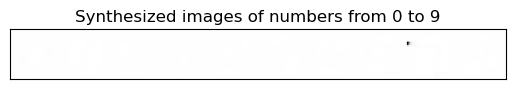

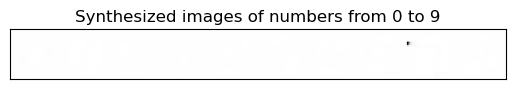

For the non standardized set:


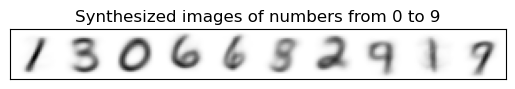

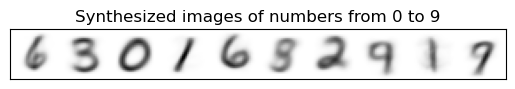

In [ ]:
# Gaussian Mixture model
def gmm():
    # Generate a GMM model with 10 components and fit it to the preprocessed and smaller training dataset
    # 1st model for the standardized data, which will converge faster (more efficiently) and have higher accuracy
    # 2nd for visualization purposes, but slower convergence and lower accuracy
    gmm = gm(n_components=10, covariance_type='full', random_state=42, tol=0.001, max_iter=2000, n_init = 3, init_params='kmeans')
    gmm2 = gm(n_components=10, covariance_type='full', random_state=42, tol=0.001, max_iter=2000, n_init = 3, init_params='kmeans')
    gmm.fit(train_8k)
    gmm2.fit(trains[:8000])
    # Calculate the the per-sample average log-likelihood (score) on the training and test set
    train_score = gmm.score(st_train[samples_size:]) # truncated training set
    test_score = gmm.score(st_test)
    train_score2 = gmm2.score(st_train[samples_size:]) # truncated training set
    test_score2 = gmm2.score(st_test)
    print("Train score (stand.): ", train_score)
    print("Test score (stand.): ", test_score)
    print("Train score: ", train_score2)
    print("Test score: ", test_score2)

    # Calculate the accuracy on the training and test set
    ptrain_labels = gmm.predict(st_train[samples_size:]) # predict labels for the truncated training set
    ptest_labels = gmm.predict(st_test) # predict labels for the test set
    ptrain_labels2 = gmm2.predict(st_train[samples_size:]) # predict labels for the truncated training set
    ptest_labels2 = gmm2.predict(st_test) # predict labels for the test set

     # Create the confusion matrices for the truncated training set and the test set
    conf_mat = confusion_matrix(train_label[samples_size:], ptrain_labels)
    conf_mat2 = confusion_matrix(test_label, ptest_labels)
    conf_mat3 = confusion_matrix(train_label[samples_size:], ptrain_labels2)
    conf_mat4 = confusion_matrix(test_label, ptest_labels2)
    # Use the Hungarian algorithm (linear_sum_assignment) to find the best mappings
    row_ind, col_ind = linear_sum_assignment(conf_mat, maximize=True)
    row_ind2, col_ind2 = linear_sum_assignment(conf_mat2, maximize=True)
    row_ind3, col_ind3 = linear_sum_assignment(conf_mat3, maximize=True)
    row_ind4, col_ind4 = linear_sum_assignment(conf_mat4, maximize=True)
    # Create mapping dictionaries
    label_mapping = {x: y for x, y in zip(col_ind, row_ind)}
    label_mapping2 = {x: y for x, y in zip(col_ind2, row_ind2)}
    label_mapping3 = {x: y for x, y in zip(col_ind3, row_ind3)}
    label_mapping4 = {x: y for x, y in zip(col_ind4, row_ind4)}
    # Map the predicted labels to the true labels
    mapped_labels = [label_mapping[label] for label in ptrain_labels]
    mapped_labels2 = [label_mapping2[label] for label in ptest_labels]
    mapped_labels3 = [label_mapping3[label] for label in ptrain_labels2]
    mapped_labels4 = [label_mapping4[label] for label in ptest_labels2]

    train_accuracy = accuracy_score(train_label[samples_size:], mapped_labels)
    test_accuracy = accuracy_score(test_label, mapped_labels2)
    train_accuracy2 = accuracy_score(train_label[samples_size:], mapped_labels3)
    test_accuracy2 = accuracy_score(test_label, mapped_labels4)
    print(f"Train accuracy (stand.): {train_accuracy*100:.2f}%")
    print(f"Test accuracy (stand.): {test_accuracy*100:.2f}%")
    print(f"Train accuracy: {train_accuracy2*100:.2f}%")
    print(f"Test accuracy: {test_accuracy2*100:.2f}%")

    print("\n1st 20 predicted train labels (stand.): ", np.array(mapped_labels[:20]))
    print("1st 20 original train labels:           ", train_label[samples_size:samples_size+20],"\n")
    print("1st 20 predicted test labels (stand.):  ", np.array(mapped_labels2[:20]))
    print("1st 20 original test labels:            ", test_label[:20])

    print("\n1st 20 predicted train labels: ", np.array(mapped_labels3[:20]))
    print("1st 20 original train labels:  ", train_label[samples_size:samples_size+20],"\n")
    print("1st 20 predicted test labels:  ", np.array(mapped_labels4[:20]))
    print("1st 20 original test labels:   ", test_label[:20])

    print("\nFor the standardized set:")
    sampler(gmm, label_mapping, None)
    sampler(gmm, label_mapping2, None)

    print("For the non standardized set:")
    sampler(gmm2, label_mapping3, None)
    sampler(gmm2, label_mapping4, None)

gmm()


<h3>Principal Component Analysis (PCA):</h3><br/>

PCA is a statistical technique used to reduce the dimensionality of high-dimensional data while preserving the most important information. It works by selecting the most important features that capture maximum information about the dataset. These features are selected based on the variance that they cause in the output (vectors with directions of maximum variance in the data).

<div style="text-align:center;font-size: 12px">
<figure>
       <img  src="GaussianScatterPCA.png" alt="attachment:GaussianScatterPCA.png" style="width:40%">
       <figcaption>
           <a  href="https://commons.wikimedia.org/wiki/File:GaussianScatterPCA.svg">             
           https://commons.wikimedia.org/wiki/File:GaussianScatterPCA.svg</a> by Nicoguaro (CCA 4.0)
       </figcaption>
</figure>
</div>


It uses an orthogonal transformation to convert a set of observations of possibly correlated variables into a set of values of linearly uncorrelated variables called principal components. This transformation is defined in such a way that the first principal component has the largest possible variance (that is, accounts for as much of the variability in the data as possible), and each succeeding component in turn has the highest variance possible under the constraint that it is orthogonal to the preceding components. (hence -> orthogonal decomposition)

<ul>
    <li><b>Computation of COV-Matrix:</b> <br>After the data has been standardized to have a mean of 0 and a standard deviation of 1, the covariance matrix is computed which depicts the covariance between the dimensions. If the covariance is positive, the variables increase together, if it’s negative, they decrease.
    <br><center>\(\mathbf{C} = \mathbf{A}^T\mathbf{A}\) <br>(\(\mathbf{A}\)... stand. data , \(\mathbf{C}\)... cov. matrix) </center></li>
    <br>
    <li><b>Calculation of Eigenvectors and Eigenvalues:</b> <br>Eigenvectors represent directions in the feature space, while eigenvalues represent magnitude or importance. The eigenvectors with the highest corresponding eigenvalues are the principal components. They are calculated by means of the eigendecompositon:
    <br><center> \(\mathbf{C} = \mathbf{Q}\mathbf{\Lambda} \mathbf{Q}^T\) <br> (\(\mathbf{Q}\)... matrix of eigenvectors (each column is an eigenvector), \(\mathbf{\Lambda}\)... diagonal matrix of eigenvalues) </center></li>
    <br>
    <li><b>Selection of Principal Components:</b> <br>The number of principal components is less than or equal to the number of original variables (in the case of MNIST < 784). This step involves selecting the top k eigenvectors, based on their corresponding explained variance (eigenvalues). Finally a new dataset is created based on principal components.</li>
</ul>

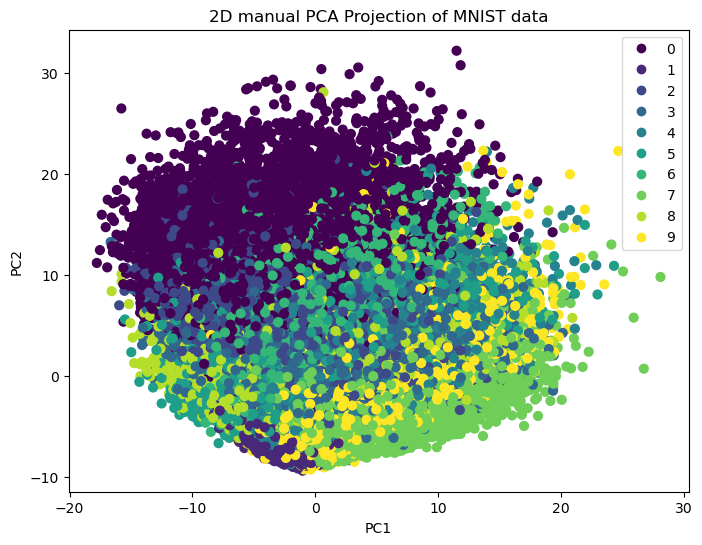

In [ ]:
def man_pca():
    # find the co-variance matrix which is : A^T * A
    covar_matrix = np.matmul(st_train.T , st_train)

    # finding the top two eigen-values and corresponding eigen-vectors for projecting onto a 2-Dim space.

    # the parameter 'eigvals' is defined (low value to heigh value) and returns the eigen values in asending order
    # this code generates the top 2 (782 and 783)(index) eigenvalues, which explain the most variance in the data.
    values, vectors = eigh(covar_matrix, eigvals=(782,783))

    # converting the eigen vectors into (2,d) shape for easyness of further computations
    vectors = vectors.T
    # vectors[0]/vectors[1] represent the 2nd/1st principal eigen vectors

    # projecting the original data sample on the plane formed by two principal eigen vectors by vector-vector multiplication.
    new_coordinates = np.matmul(vectors, st_train.T).T

    plot3(new_coordinates, train_label, "2D manual PCA Projection of MNIST data")
man_pca()

def man_pca3d():
    # find the co-variance matrix which is : A^T * A
    covar_matrix = np.matmul(st_train.T , st_train)

    # finding the top three eigen-values and corresponding eigen-vectors for projecting onto a 3-Dim space.

    # the parameter 'eigvals' is defined (low value to heigh value) and returns the eigen values in asending order
    # this code generates the top 3 (781, 782 and 783)(index) eigenvalues, which explain the most variance in the data.
    values, vectors = eigh(covar_matrix, eigvals=(781, 783))

    # converting the eigen vectors into (3,d) shape for easyness of further computations
    vectors = vectors.T
    # vectors[0]/vectors[1]/vectors[2] represent the 3rd/2nd/1st principal eigen vectors

    # projecting the original data sample on the plane formed by three principal eigen vectors by vector-vector multiplication.
    new_coordinates = np.matmul(vectors, st_train.T).T

    plot3d(new_coordinates, train_label, "3D manual PCA Projection of MNIST data")

man_pca3d()

<h3>PCA with sklearn package:</h3><br>
<b>The sklearn.decomposition.PCA package</b> is using <b>Singular Value Decomposition (SVD)</b> from LAPACK. In linear algebra, SVD is a factorization of a real or complex matrix. It generalizes the eigendecomposition of a square normal matrix with an orthonormal eigenbasis to any matrix. It is a method of decomposing a matrix into three other matrices. <br><center>$\mathbf{C} = \mathbf{U}\mathbf{\Sigma} \mathbf{V}^T$ <br>($\mathbf{C}$... cov. matrix, $\mathbf{U}$... m×m matrix (columns are the eigenvectors of $\mathbf{C}\mathbf{C}^T$),<br> $\mathbf{\Sigma}$... (diagonal) singular value matrix with $\mathbf{\Sigma_{ii}} = \sigma_i = \sqrt{\lambda_i}$ ($\lambda_i$... Eigenvalues), $\mathbf{V}$... nxn matrix (columns are the eigenvectors of $\mathbf{C}^T\mathbf{C}$ ) </center>
<br>
The SVD represents an expansion of the original data in a coordinate system where the covariance matrix is diagonal. This makes the SVD very useful in signal processing and statistics.

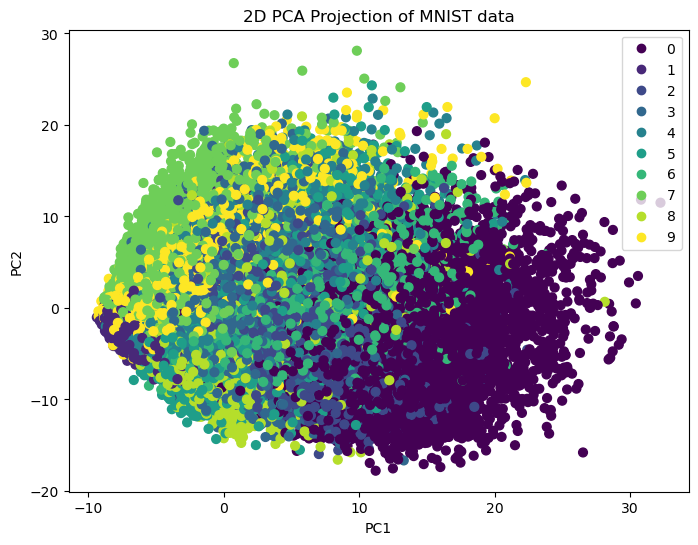

In [ ]:
def pca2d(): # 2D PCA function
    # create a PCA object with 2 components
    pca = PCA(n_components=2, random_state=42)
    trainx_pca = pca.fit_transform(st_train)

    plot3(trainx_pca, train_label, "2D PCA Projection of MNIST data")


def pca3d(): # 3D PCA function
    # create a PCA object with 3 components
    pca = PCA(n_components=3)
    trainx_pca = pca.fit_transform(st_train)

    plot3d(trainx_pca, train_label, "3D PCA Projection of MNIST data")

pca2d()
pca3d()


<h3>Dimensionality reduction analysis:</h3> <br>
The (cumulative) explained variance (CEV) in this part measures how much of the variation in the data can be explained by the principle components (aka. reduced dimensions, features). The goal would f.e. be to find optimal compromise between the retained variance and the number of reduced dimensions. Observation: The higher the sample size the higher the Nr of PCs must be to obtain a higher CEV.

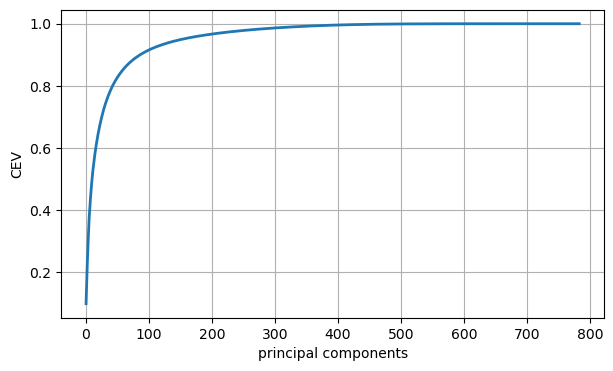

10 principal components explain 50.0% of total variation.
16 principal components explain 60.0% of total variation.
25 principal components explain 70.0% of total variation.
43 principal components explain 80.0% of total variation.
58 principal components explain 85.0% of total variation.
86 principal components explain 90.0% of total variation.
153 principal components explain 95.0% of total variation.
330 principal components explain 99.0% of total variation.

Recreated the 10 first images with different PCs:


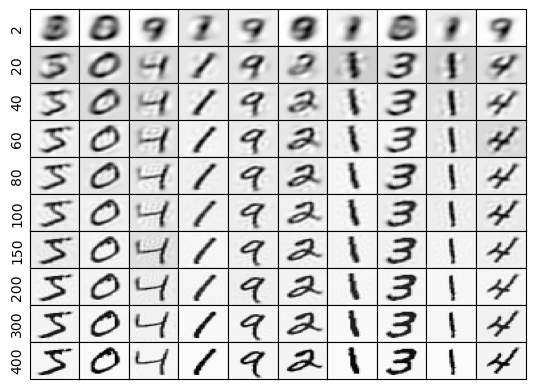

In [ ]:
def cev(train_8k): # Dimensionality reduction analysis

    pca_full = PCA(random_state=42) # with all 784 components
    pca_full.fit_transform(train_8k)
    ev1 = pca_full.explained_variance_
    cev1 = np.cumsum(ev1/np.sum(ev1))

    plt.figure(1, figsize=(7, 4))
    plt.plot(cev1, linewidth=2)
    plt.grid()
    plt.xlabel("principal components")
    plt.ylabel("CEV")
    plt.show()

    per = np.array([0.5, 0.6, 0.7, 0.8, 0.85, 0.9, 0.95, 0.99])
    pc_gen = [print(f"{np.min(np.where(cev1>n))} principal components explain {n*100}% of total variation.") for n in per]

    comps = np.array([2, 20, 40, 60, 80, 100, 150, 200, 300, 400])
    new = []
    for n in comps:
        pca = PCA(n_components=n, random_state=42)
        train_pca = pca.fit_transform(train_8k)
        inv = pca.inverse_transform(train_pca)
        new = np.append(new, inv[:10, :])

    print("\nRecreated the 10 first images with different PCs:")
    plot4(new.reshape(100, 28, 28), comps)

cev(trains)

<h3>Bayesian information criterion (BIC) & Akaike information criterion (AIC) analysis</h3><br>
BIC and AIC analysis with different GMM component sizes and 40 principal components (PCs) for the PCA. Expected plot should contain a globlal minimum for the BIC and/or AIC. The component size at the global minimum of either of the criterions can be used as a suitable GMM parameter. (For this code to work it should be between 10 and 19)

<h4>Note: Run the "bic_aic" cell to obtain the component Nr. of the best BIC/AIC value for the GMM model in the "pca_gmm" cell.</h4>

components:  2
components:  4
components:  6
components:  8
components:  10
components:  12
components:  14
components:  16
components:  18
components:  20
components:  22
Best number of components (BIC): [14], BIC value: 4083922.7721819254
Best number of components (AIC): [22], AIC value: 3963673.6013003467
BIC chosen with component size:  14


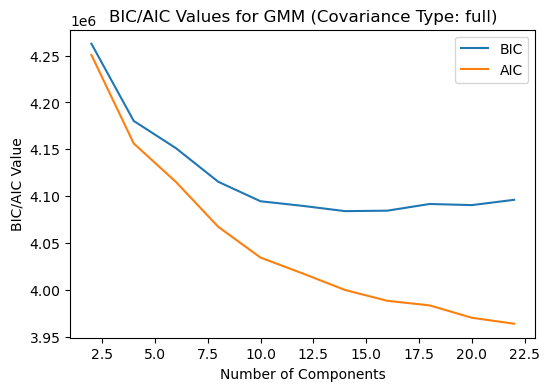

In [ ]:
def bic_aic(train):

    pca = PCA(n_components=40, random_state=42)
    train = pca.fit_transform(train)

    component_sizes = np.arange(2, 23, 2)
    # Loop through each component size
    gmmx = [(print("components: ", n), gm(n_components=n, covariance_type='full', random_state=42, max_iter=1000, n_init=2).fit(train)) for n in component_sizes]
    gmm = [t[1] for t in gmmx]
    aics = [m.aic(train) for m in gmm]
    bics = [m.bic(train) for m in gmm]
    best_bic, best_aic = np.min(bics), np.min(aics)
    best_cnr_bic = component_sizes[np.where(bics == best_bic)[0]]
    best_cnr_aic = component_sizes[np.where(aics == best_aic)[0]]

    print(f"Best number of components (BIC): {best_cnr_bic}, BIC value: {best_bic}")
    print(f"Best number of components (AIC): {best_cnr_aic}, AIC value: {best_aic}")

    best_cnr = np.min(np.array([best_cnr_bic, best_cnr_aic]))
    if(best_cnr==best_cnr_bic):
        print("BIC chosen with component size: ", best_cnr)
    else:
        print("AIC chosen with component size: ", best_cnr)

    plt.figure(figsize=(6, 4))
    plt.plot(component_sizes, bics, label='BIC')
    plt.plot(component_sizes, aics, label='AIC')
    plt.xlabel("Number of Components")
    plt.ylabel("BIC/AIC Value")
    plt.title(f"BIC/AIC Values for GMM (Covariance Type: full)")
    plt.legend()
    plt.show()

    return best_cnr

best_cnr = bic_aic(trains[:8000])

<b>Testing the model with the evaluated components nr and 10 components. (theoretically one component per number) <br> The excess clusters (> 9) are assigned to their nearest clusters. </b>

Evaluated (auto) GMM components Nr.:  14
Train set score n_comp:auto: -249.6951323293258
Test set score n_comp:auto: -249.84081339004882
Train set score n_comp:10: -252.15722419010115
Test set score n_comp:10: -252.2597584662327
Train accuracy n_comp:auto : 56.16%
Test accuracy n_comp:auto : 56.41%
Train accuracy n_comp:10 : 63.10%
Test accuracy n_comp:10 : 63.96%

20 predicted train labels (auto):  [3 4 9 5 9 2 1 3 1 9 3 8 3 6 1 7 2 8 6 9]
20 original train labels:          [5 0 4 1 9 2 1 3 1 4 3 5 3 6 1 7 2 8 6 9] 


20 predicted test labels (auto):  [7 2 4 5 9 4 9 9 3 9 0 6 9 0 1 3 9 7 3 9]
20 original test labels:          [7 2 1 0 4 1 4 9 5 9 0 6 9 0 1 5 9 7 3 4] 


20 predicted train labels:         [3 0 4 5 9 2 1 3 1 4 8 8 3 6 1 7 2 8 6 7]
20 original train labels (ten):    [5 0 4 1 9 2 1 3 1 4 3 5 3 6 1 7 2 8 6 9] 


20 predicted test labels:         [7 2 5 0 4 5 4 4 3 7 0 6 9 0 1 3 9 7 3 9]
20 original test labels (ten):    [7 2 1 0 4 1 4 9 5 9 0 6 9 0 1 5 9 7 3 4] 

For the t

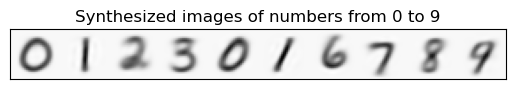

For the test set (auto):


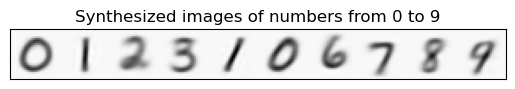

For the training set (ten):


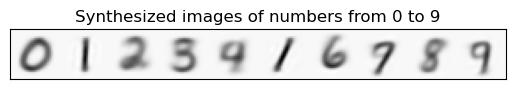

For the test set (ten):


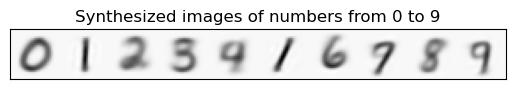

In [ ]:
def pca_gmm(train):
    st_test = tests
    pca = PCA(n_components=40, random_state=42)
    train_pca = pca.fit_transform(train)
    test_pca = pca.transform(tests)

    print("Evaluated (auto) GMM components Nr.: ", best_cnr)
    bgmm_pca = gm(n_components=best_cnr, covariance_type='full', random_state=42, max_iter=1000, n_init = 2, init_params='kmeans').fit(train_pca)
    tgmm_pca = gm(n_components=10, covariance_type='full', random_state=42, max_iter=1000, n_init = 2, init_params='kmeans').fit(train_pca)
    print("Train set score n_comp:auto:", bgmm_pca.score(train_pca))
    print("Test set score n_comp:auto:", bgmm_pca.score(test_pca))
    print("Train set score n_comp:10:", tgmm_pca.score(train_pca))
    print("Test set score n_comp:10:", tgmm_pca.score(test_pca))

    # Calculate the accuracy on the training and test set
    ptrain_blabels = bgmm_pca.predict(train_pca) # predict training labels for model auto
    ptest_blabels = bgmm_pca.predict(test_pca) # predict test labels for model auto
    ptrain_tlabels = tgmm_pca.predict(train_pca) # predict training labels for model ten
    ptest_tlabels = tgmm_pca.predict(test_pca) # predict test labels for model ten

    if(best_cnr > 10):
        # Calculate the means of the clusters
        cluster_means = bgmm_pca.means_
        # Calculate the distance between the means of the extra clusters and the original clusters
        distances = cdist(cluster_means[10:], cluster_means[:10])
        # For each extra cluster, find the most similar original cluster
        similar_clusters = distances.argmin(axis=1)
        # Number of extra clusters
        extra_clusters = best_cnr - 10

        # Create a mapping from the extra clusters to the most similar original clusters
        extra_cluster_mapping = {i + 10: similar_clusters[i] for i in range(extra_clusters)}

        # Map the predicted labels of the extra clusters to the most similar original clusters
        ptrain_blabels = np.array([extra_cluster_mapping[label] if label in extra_cluster_mapping else label for label in ptrain_blabels])
        ptest_blabels = np.array([extra_cluster_mapping[label] if label in extra_cluster_mapping else label for label in ptest_blabels])

    # Create the confusion matrices for the training- and test set
    conf_mat = confusion_matrix(train_label, ptrain_blabels)
    conf_mat2 = confusion_matrix(test_label, ptest_blabels)
    conf_mat3 = confusion_matrix(train_label, ptrain_tlabels)
    conf_mat4 = confusion_matrix(test_label, ptest_tlabels)
    # Use the Hungarian algorithm (linear_sum_assignment) to find the best mappings
    row_ind, col_ind = linear_sum_assignment(conf_mat, maximize=True)
    row_ind2, col_ind2 = linear_sum_assignment(conf_mat2, maximize=True)
    row_ind3, col_ind3 = linear_sum_assignment(conf_mat3, maximize=True)
    row_ind4, col_ind4 = linear_sum_assignment(conf_mat4, maximize=True)
    # Create mapping dictionaries
    label_mapping = {x: y for x, y in zip(col_ind, row_ind)}
    label_mapping2 = {x: y for x, y in zip(col_ind2, row_ind2)}
    label_mapping3 = {x: y for x, y in zip(col_ind3, row_ind3)}
    label_mapping4 = {x: y for x, y in zip(col_ind4, row_ind4)}
    # Map the predicted labels to the true labels
    mapped_labels = [label_mapping[label] for label in ptrain_blabels]
    mapped_labels2 = [label_mapping2[label] for label in ptest_blabels]
    mapped_labels3 = [label_mapping3[label] for label in ptrain_tlabels]
    mapped_labels4 = [label_mapping4[label] for label in ptest_tlabels]

    train_baccuracy = accuracy_score(train_label, mapped_labels)
    test_baccuracy = accuracy_score(test_label, mapped_labels2)
    train_taccuracy = accuracy_score(train_label, mapped_labels3)
    test_taccuracy = accuracy_score(test_label, mapped_labels4)
    print(f"Train accuracy n_comp:auto : {train_baccuracy*100:.2f}%")
    print(f"Test accuracy n_comp:auto : {test_baccuracy*100:.2f}%")
    print(f"Train accuracy n_comp:10 : {train_taccuracy*100:.2f}%")
    print(f"Test accuracy n_comp:10 : {test_taccuracy*100:.2f}%")

    print("\n20 predicted train labels (auto): ", np.array(mapped_labels[:20]))
    print("20 original train labels:         ", train_label[:20],"\n")
    print("\n20 predicted test labels (auto): ", np.array(mapped_labels2[:20]))
    print("20 original test labels:         ", test_label[:20],"\n")
    print("\n20 predicted train labels:        ", np.array(mapped_labels3[:20]))
    print("20 original train labels (ten):   ", train_label[:20],"\n")
    print("\n20 predicted test labels:        ", np.array(mapped_labels4[:20]))
    print("20 original test labels (ten):   ", test_label[:20],"\n")

    print("For the training set (auto):")
    sampler(bgmm_pca, label_mapping, pca)
    print("For the test set (auto):")
    sampler(bgmm_pca, label_mapping2, pca)
    print("For the training set (ten):")
    sampler(tgmm_pca, label_mapping3, pca)
    print("For the test set (ten):")
    sampler(tgmm_pca, label_mapping4, pca)

pca_gmm(trains)

<h3>t-Distributed Stochastic Neighbor Embedding (t-SNE)</h3><br>

t-SNE is a nonlinear dimensionality reduction technique that aims to visualize high-dimensional data in a low-dimensional space (usually two or three dimensions). It works by preserving the pairwise similarities between data points, such that similar points are mapped close together and dissimilar points are mapped far apart in the low-dimensional space. <br><br>


<b>The t-SNE algorithm includes two main stages: </b>
<ul>
    <li>
        First, t-SNE constructs a probability distribution over pairs of high-dimensional objects in such a way that similar
        objects are assigned a higher probability while dissimilar points are assigned a lower probability.
    </li> <br>
    <li>
        Second, t-SNE defines a similar probability distribution over the points in the low-dimensional map, and it minimizes
        the Kullback–Leibler divergence (KL divergence) between the two distributions with respect to the locations of the
        points in the map.
    </li>
</ul>
<br>
<b>The Kullback-Leibler (KL) divergence</b>, also known as relative entropy or the cost function, is a measure of how one probability distribution is different from a second, reference probability distribution. It’s used to quantify the difference between the actual and observed probability distributions. It is not convex, i.e. with different initializations one can get different results.<br><br>
The KL divergence of a distribution P from a distribution Q is defined as:<br>
<center>$D_{KL}(P||Q) = \sum_{i} P(i) \log \frac{P(i)}{Q(i)}$</center> <br>
In this formula, the sum is over all events i, $P(i)$ is the probability of event i according to distribution $P$. <br>
$Q(i)$ is the probability of event i according to distribution $Q$.<br> <br>

T-SNE has some parameters that affect the quality and speed of the visualization, such as the number of components (the dimensionality of the low-dimensional space), the perplexity (a measure of the effective number of neighbors for each point), the learning rate (the step size for the gradient descent optimization), and the number of iterations (the maximum number of times the algorithm runs the E-step and M-step).<br><br>

In depth (process) description of the t-distributed stochastic neighbor embedding (t-SNE) algorithm concerning the MNIST dataset: <br/>
<a href="https://lvdmaaten.github.io/publications/papers/JMLR_2008.pdf">https://lvdmaaten.github.io/publications/papers/JMLR_2008.pdf</a><br/>
Small overview and FAQ - t-SNE by Laurens van der Maaten: <br/>
<a href="https://lvdmaaten.github.io/tsne">https://lvdmaaten.github.io/tsnen</a>

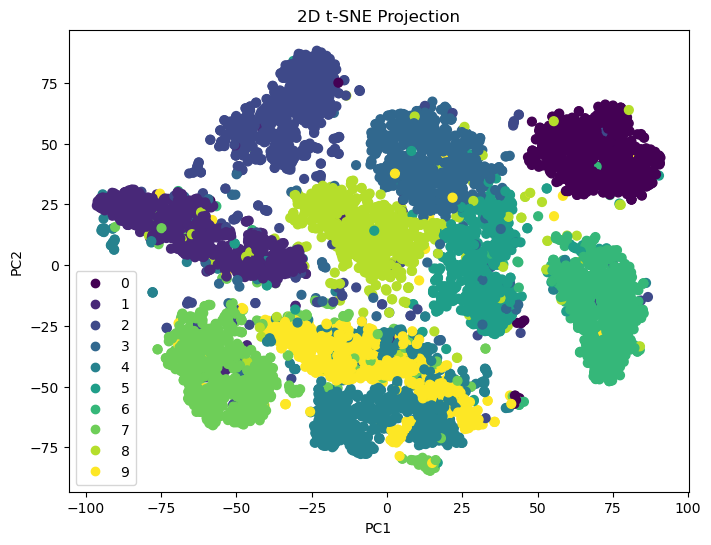

In [ ]:
def t_sne(train, labels):

    def tsne2d(perp, iters):

        tsm = TSNE(n_components=2, random_state=42, perplexity=perp,  n_iter=iters)
        tsm_train = tsm.fit_transform(train)
        plot3(tsm_train, labels, "2D t-SNE Projection")

    def tsne3d(perp, iters):

        tsm = TSNE(n_components=3, random_state=42, perplexity=perp,  n_iter=iters)
        tsm_train = tsm.fit_transform(train)
        plot3d(tsm_train, labels, "3D t-SNE Projection")

    tsne2d(30, 1500)
    tsne3d(30, 1500)

t_sne(trains[0:8000], train_label_8k)

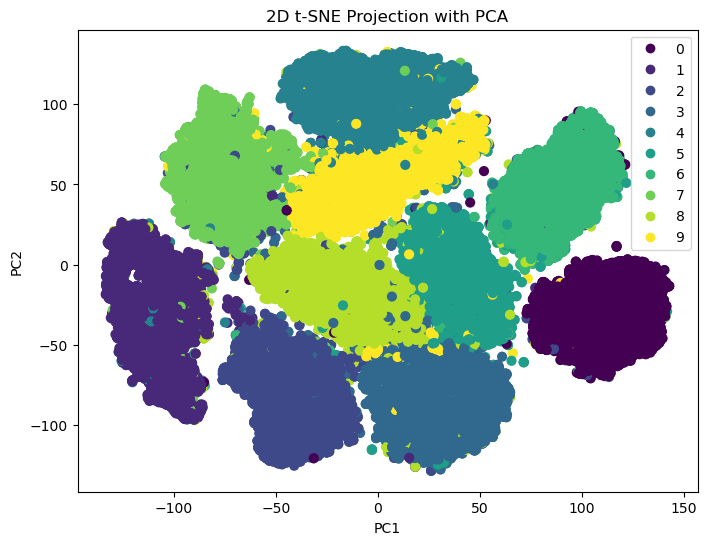

In [ ]:
def pca_tsne(train, labels):
    def pca_2dtsne(P, perp, iters):

        pca = PCA(n_components=P, random_state=42) # create a PCA object with P components
        train_pca = pca.fit_transform(train) # fit and transfrom the training data

        tsm = TSNE(n_components=2, random_state=42, perplexity=perp,  n_iter=iters)
        tsm_train = tsm.fit_transform(train_pca)

        plot3(tsm_train, labels, "2D t-SNE Projection with PCA")

        return tsm_train

    def pca_3dtsne(P, perp, iters):

        pca = PCA(n_components=P, random_state=42) # create a PCA object with P components
        train_pca = pca.fit_transform(train) # fit and transfrom the training data

        tsm = TSNE(n_components=3, random_state=42, perplexity=perp,  n_iter=iters)
        tsm_train = tsm.fit_transform(train_pca)

        plot3d(tsm_train, labels, "3D t-SNE Projection with PCA")

        return tsm_train

    return pca_2dtsne(40, 30, 1500), pca_3dtsne(40, 30, 1500)

tsne2d_train, tsne3d_train = pca_tsne(trains, train_label)

Use the result from pca_2dtsne/pca_3dtsne to train a GMM ten (10 components) model and check accuracy:
Since t-SNE cannot transform new data, only the trained data-/model- accuracy will be checked.

In [ ]:
def tsne_gmm(train2d, train3d):

    gmm_tsne2d = gm(n_components=10, covariance_type='full', random_state=35, max_iter=1000, n_init = 2, init_params='kmeans').fit(train2d)
    gmm_tsne3d = gm(n_components=10, covariance_type='full', random_state=35, max_iter=1000, n_init = 2, init_params='kmeans').fit(train3d)
    print("Train set score:", gmm_tsne2d.score(train2d))
    print("Train set score:", gmm_tsne3d.score(train3d))

    # Calculate the accuracy on the training and test set
    ptrain_labels = gmm_tsne2d.predict(train2d) # predict training labels for 2d data
    ptrain_labels2 = gmm_tsne3d.predict(train3d) # predict training labels for 3d data

    # Create the confusion matrices for the training- and test set
    conf_mat = confusion_matrix(train_label, ptrain_labels)
    conf_mat2 = confusion_matrix(train_label, ptrain_labels2)

    # Use the Hungarian algorithm (linear_sum_assignment) to find the best mappings
    row_ind, col_ind = linear_sum_assignment(conf_mat, maximize=True)
    row_ind2, col_ind2 = linear_sum_assignment(conf_mat2, maximize=True)

    # Create mapping dictionaries
    label_mapping = {x: y for x, y in zip(col_ind, row_ind)}
    label_mapping2 = {x: y for x, y in zip(col_ind2, row_ind2)}

    # Map the predicted labels to the true labels
    mapped_labels = [label_mapping[label] for label in ptrain_labels]
    mapped_labels2 = [label_mapping2[label] for label in ptrain_labels2]

    train_accuracy = accuracy_score(train_label, mapped_labels)
    train_accuracy2 = accuracy_score(train_label, mapped_labels2)
    print(f"Train accuracy (2d) : {train_accuracy*100:.2f}%")
    print(f"Train accuracy (3d) : {train_accuracy2*100:.2f}%")

    print("\n1st 20 predicted train labels (2d): ", np.array(mapped_labels[:20]))
    print("1st 20 original train labels (2d):  ", train_label[:20],"\n")

    print("\n1st 20 predicted train labels (3d): ", np.array(mapped_labels2[:20]))
    print("1st 20 original train labels (3d):  ", train_label[:20],"\n")


tsne_gmm(tsne2d_train, tsne3d_train)

Train set score: -10.844387144662065
Train set score: -11.933136611999387
Train accuracy (2d) : 96.15%
Train accuracy (3d) : 96.83%

1st 20 predicted train labels (2d):  [5 0 4 1 9 2 1 3 1 4 3 5 3 6 1 7 2 8 6 9]
1st 20 original train labels (2d):   [5 0 4 1 9 2 1 3 1 4 3 5 3 6 1 7 2 8 6 9] 


1st 20 predicted train labels (3d):  [5 0 4 1 9 2 1 3 1 4 3 5 3 6 1 7 2 8 6 9]
1st 20 original train labels (3d):   [5 0 4 1 9 2 1 3 1 4 3 5 3 6 1 7 2 8 6 9] 



<h3>Uniform Manifold Approximation and Projection (UMAP)</h3><br>
is a  is a stochastic algorithm and a dimension reduction technique that is competitive with t-SNE for visualization quality, arguably preserving more of the global structure with superior run time performance. But it is also useful for general non-linear dimension reduction. It makes use of randomness both to speed up approximation steps, and to aid in solving hard optimization problems. The algorithm is founded on three assumptions about the data:

- The data is uniformly distributed on Riemannian manifold.<br>

- The Riemannian metric is locally constant (or can be approximated as such).<br>

- The manifold is locally connected

UMAP, like it says in the name, projects, or embeds, the data onto a subspace. It has no computational restrictions on embedding dimension, making it viable as a general-purpose dimension reduction technique for machine learning. In contrast to t-SNE it can be used to transform the training data as well as on the (new/unknown) test data, what makes it suitable for testing the generalizability and its accuracy as well as synthesization.<br>

For more information:<br>
<a href="https://umap-learn.readthedocs.io/en/latest/">https://umap-learn.readthedocs.io/en/latest/</a>

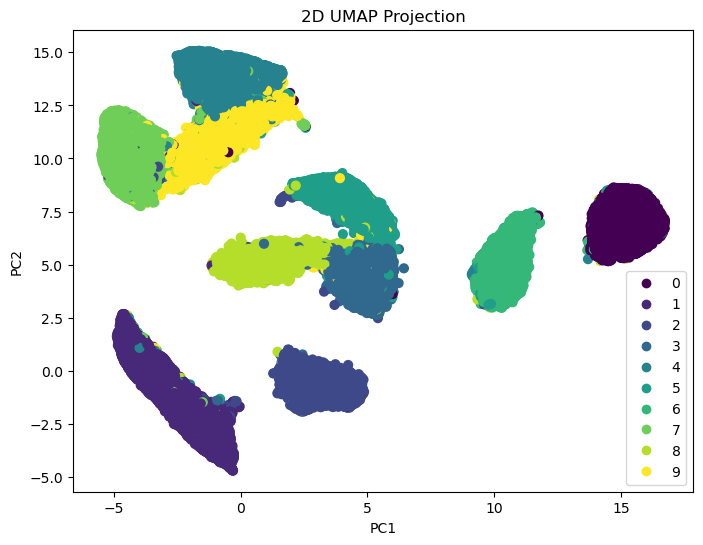

In [ ]:
def umap():
    umap_object = ump.UMAP(n_neighbors=15, min_dist=0.1, random_state=42, metric="euclidean")
    umap_train = umap_object.fit_transform(trains) # using non-preprocessed data yields (interestingly) better results
    plot3(umap_train, train_label, "2D UMAP Projection")
    umap_test = umap_object.transform(tests)

    return umap_train, umap_test, umap_object

umap_train, umap_test, mapper = umap()

<h4>Unsupervised UMAP-GMM Machine Learning algorithm with (Hungarian/Harold Kuhn algorithm) supervised evaluation and synthetization:</h4>

Train set score: -4.606799843568585
Train set score: -4.577900711580296
Train accuracy n_comp:10 : 96.63%
Test accuracy n_comp:10 : 95.46%

20 predicted train labels:  [5 0 4 1 9 2 1 3 1 4 3 5 3 6 1 7 2 8 6 9]
20 original train labels:   [5 0 4 1 9 2 1 3 1 4 3 5 3 6 1 7 2 8 6 9] 

20 predicted test labels:   [7 2 1 0 4 1 4 9 5 9 0 6 9 0 1 5 9 7 3 4]
20 original test labels:    [7 2 1 0 4 1 4 9 5 9 0 6 9 0 1 5 9 7 3 4]

For the training set:


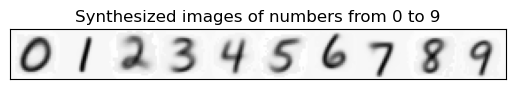

For the test set:


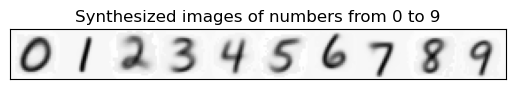

In [ ]:
def umap_gmm(train, test, mapper):

    gmm_umap = gm(n_components=10, covariance_type='full', random_state=34, max_iter=750, n_init = 2, init_params='kmeans').fit(umap_train)

    print("Train set score:", gmm_umap.score(train))
    print("Test set score:", gmm_umap.score(test))

    # Calculate the accuracy on the training and test set
    ptrain_labels = gmm_umap.predict(train) # predict training labels
    ptest_labels = gmm_umap.predict(test) # predict training labels

    # Create the confusion matrices for the training- and test set
    conf_mat = confusion_matrix(train_label, ptrain_labels)
    conf_mat2 = confusion_matrix(test_label, ptest_labels)

    # Use the Hungarian algorithm (linear_sum_assignment) to find the best mappings
    row_ind, col_ind = linear_sum_assignment(conf_mat, maximize=True)
    row_ind2, col_ind2 = linear_sum_assignment(conf_mat2, maximize=True)

    # Create mapping dictionaries
    label_mapping = {x: y for x, y in zip(col_ind, row_ind)}
    label_mapping2 = {x: y for x, y in zip(col_ind2, row_ind2)}

    # Map the predicted labels to the true labels
    mapped_labels = [label_mapping[label] for label in ptrain_labels]
    mapped_labels2 = [label_mapping2[label] for label in ptest_labels]

    train_accuracy = accuracy_score(train_label, mapped_labels)
    test_accuracy = accuracy_score(test_label, mapped_labels2)
    print(f"Train accuracy n_comp:10 : {train_accuracy*100:.2f}%")
    print(f"Test accuracy n_comp:10 : {test_accuracy*100:.2f}%")

    print("\n20 predicted train labels: ", np.array(mapped_labels[:20]))
    print("20 original train labels:  ", train_label[:20],"\n")
    print("20 predicted test labels:  ", np.array(mapped_labels2[:20]))
    print("20 original test labels:   ", test_label[:20])

    print("\nFor the training set:")
    sampler(gmm_umap, label_mapping, mapper)
    print("For the test set:")
    sampler(gmm_umap, label_mapping2, mapper)

umap_gmm(umap_train, umap_test, mapper)

With around 96 % model accuracy with the PCA/t-SNE/GMM approach and around 96 % generalized accuracy with the UMAP/GMM approach the resulting accuracy is fairly good. Popular results have around 95-99.8 % accuracy. Different results can have various reasons. F.e. different parameters at different modelling/decompsing/mapping steps. Sometimes the MNIST datasets are larger (70000) or smaller (42000). Some use different models or ML techniques like neural networks or wrapped Gaussian models. Even the GMM model itself can change the accuracy measurably with different random intializations (param:"random_state").